In [1]:
from __future__ import print_function, absolute_import
import numpy as np
from scipy import signal, fft, io
from matplotlib import pyplot as plt

In [2]:
data = io.loadmat('../data/eth/ID1/Sz1.mat')

In [3]:
dt = np.arange(0, len(data['EEG'])/512, 1/512)

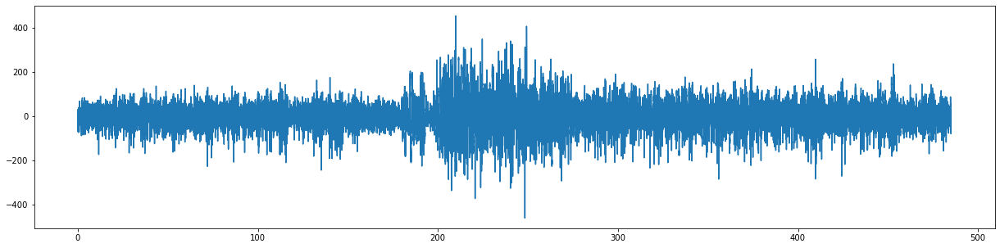

In [4]:
plt.figure(figsize=(21,5))
plt.plot(dt, data['EEG'][:,15])

## STFT analysis begins here

In [5]:
nperseg=500*512//1000 # 500ms
f, t, ds = signal.stft(data['EEG'][:,0], fs=512, nperseg=nperseg, detrend='constant')

In [6]:
t = t[3:-3]
ds = np.abs(ds[:,3:-3])
idx = np.squeeze(np.where(f>=200))[0]
f = f[:idx]
ds = ds[:idx,:]
ds[0,:] = 0

<ipython-input-7-155d0c669c00>:1: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t, f, np.log10(ds), shading='nearest'); plt.colorbar();


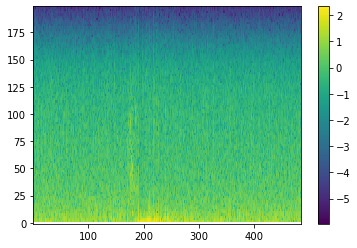

In [7]:
plt.pcolormesh(t, f, np.log10(ds), shading='nearest'); plt.colorbar();

In [ ]:
from sklearn.preprocessing import normalize

In [ ]:
dtft_norm = normalize(ds, norm='l2', copy=True, axis=0)

<ipython-input-16-2385d93c95c2>:1: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t,f,np.log10(dtft_norm), shading='nearest'); plt.colorbar();


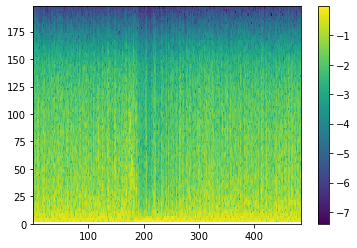

In [ ]:
plt.pcolormesh(t,f,np.log10(dtft_norm), shading='nearest'); plt.colorbar();

In [ ]:
from sklearn.clustering import MiniBatchKMeans

In [17]:
mean_ds = np.mean(dtft_norm, axis=1)

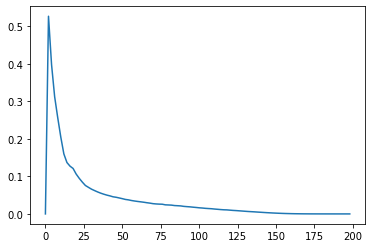

In [18]:
plt.plot(f, mean_ds)

In [19]:
ds_mc = ((dtft_norm.T - mean_ds).T).copy()

<ipython-input-20-42b6aa1973e5>:1: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t,f,np.log10(ds_mc), shading='nearest'); plt.colorbar();
<ipython-input-20-42b6aa1973e5>:1: RuntimeWarning: invalid value encountered in log10
  plt.pcolormesh(t,f,np.log10(ds_mc), shading='nearest'); plt.colorbar();


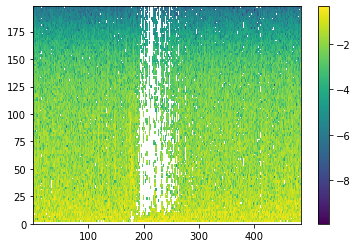

In [20]:
plt.pcolormesh(t,f,np.log10(ds_mc), shading='nearest'); plt.colorbar();

## SVD of DTFT

In [21]:
u1, s1, vh1 = np.linalg.svd(ds_mc, full_matrices=False)

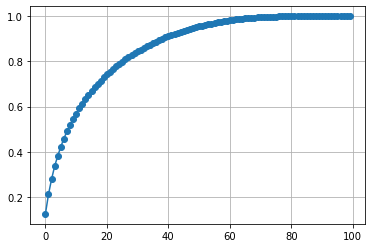

In [22]:
plt.plot(np.cumsum(s1)/np.sum(s1), 'o-'); plt.grid();

In [303]:
ncomps = np.squeeze(np.where(np.cumsum(s1)/np.sum(s1) >= 0.75))[0]
print(ncomps)

21


In [304]:
ds_approx = u1[:,:ncomps] @ np.diag(s1[:ncomps]) @ vh1[:ncomps,:]

<ipython-input-305-de90de6a7680>:2: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t, f, np.log10((ds_approx.T + mean_ds.T).T), shading='nearest')
<ipython-input-305-de90de6a7680>:2: RuntimeWarning: invalid value encountered in log10
  plt.pcolormesh(t, f, np.log10((ds_approx.T + mean_ds.T).T), shading='nearest')


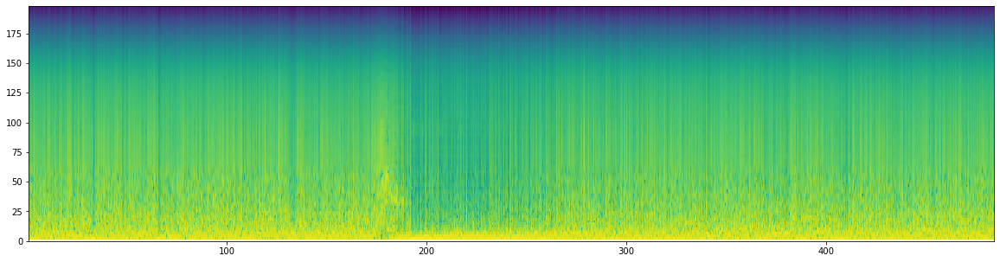

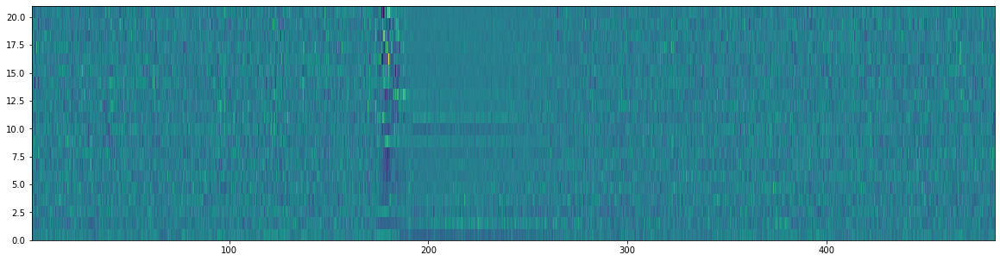

In [305]:
plt.figure(figsize=(20,5))
plt.pcolormesh(t, f, np.log10((ds_approx.T + mean_ds.T).T), shading='nearest')
plt.figure(figsize=(20,5))
plt.pcolormesh(t, np.linspace(0, ncomps, ncomps), vh1[:ncomps,:])

## GMM fit to the data

In [260]:
from sklearn.mixture import BayesianGaussianMixture

In [261]:
nevents=50
bgm = BayesianGaussianMixture(n_components=nevents, max_iter=10000, covariance_type='diag')

In [443]:
ncomps=10

In [444]:
%time bgm.fit(vh1[:ncomps,:].T)

CPU times: user 7.56 s, sys: 781 ms, total: 8.34 s
Wall time: 1.52 s


BayesianGaussianMixture(covariance_type='diag', max_iter=10000, n_components=50)

In [445]:
bgm.converged_

True

In [446]:
res = bgm.predict(vh1[:ncomps,:].T)

In [447]:
means = (bgm.means_).T

In [448]:
ids, counts = np.unique(res, return_counts=True)
counts = counts/np.sum(counts)

In [449]:
print("Num evts: {}".format(len(np.unique(ids))))
nevts = len(np.unique(ids))

Num evts: 9


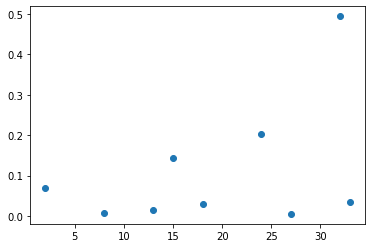

In [450]:
plt.plot(ids, counts, 'o')

In [451]:
means = means[:,ids]

In [452]:
idx = np.argsort(counts)[::-1]

In [511]:
dots = np.zeros((means.shape[1], means.shape[1]))
mean_norm = normalize(means, norm='l2', axis=0, copy=True)
for i in range(means.shape[1]):
    for j in range(means.shape[1]):
        dots[i,j] = np.dot(mean_norm[:,i], mean_norm[:,j])

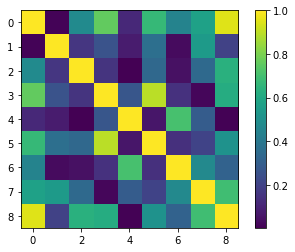

In [512]:
plt.imshow(np.abs(dots)); plt.colorbar()

In [513]:
evt_psd_mc = u1[:,:ncomps] @ np.diag(s1[:ncomps]) @ means

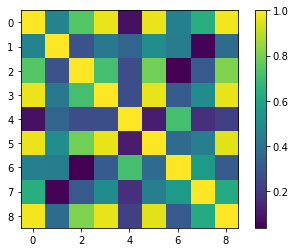

In [514]:
dots = np.zeros((evt_psd_mc.shape[1], evt_psd_mc.shape[1]))
mean_norm = normalize(evt_psd_mc, norm='l2', axis=0, copy=True)
for i in range(means.shape[1]):
    for j in range(means.shape[1]):
        dots[i,j] = np.dot(mean_norm[:,i], mean_norm[:,j])
        
plt.imshow(np.abs(dots)); plt.colorbar()

## Filter the events based on the clustering of events

## Add filtering of events with optimised cluster detection here

In [515]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics import calinski_harabasz_score as chs
from sklearn.preprocessing import OneHotEncoder

In [516]:
nclusters = np.arange(2, nevts)
scores = np.array([])
for i, n in zip(range(len(nclusters)), nclusters):
    c2s = SpectralClustering(n_clusters=n).fit_predict(mean_norm.T)
    scores = np.append(scores, chs(mean_norm.T, c2s))
    
nc = nclusters[np.squeeze(np.where(scores==max(scores)))]
sub_labels = SpectralClustering(n_clusters=nc).fit_predict(mean_norm.T)

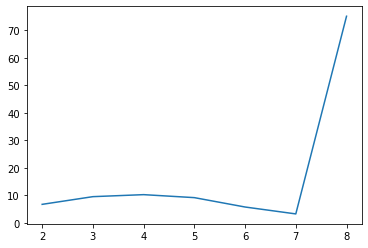

In [517]:
plt.plot(nclusters, scores)

In [509]:
means2 = np.empty((ncomps, len(sub_labels)))
for subl, i in zip(sub_labels, range(len(sub_labels))):
    idxs = sub_labels == subl
    means2[:,i] = np.mean(means[:, idxs], axis=1)

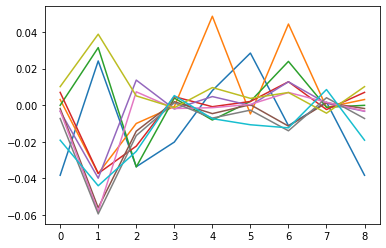

In [510]:
plt.plot(means2.T)

## Change labels of original array

In [459]:
# for every label in the original clustering, find the label in the cluster2 array and replace it

evs = np.zeros((len(res)))
for i in range(len(res)):
    this_label = np.where(ids==res[i])[0]
    new_label = sub_labels[this_label]
    evs[i] = new_label
nevs = len(np.unique(evs))

In [460]:
ids, evt_counts = np.unique(evs, return_counts=True)
evt_counts = evt_counts/np.sum(evt_counts)
idx_sort = np.argsort(evt_counts)[::-1]

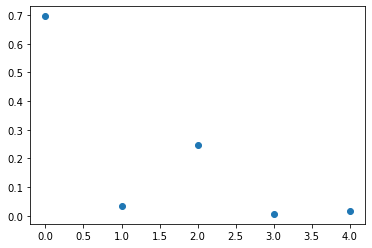

In [461]:
plt.plot(ids[idx_sort], evt_counts[idx_sort], 'o')

In [462]:
means3 = means2[:,idx_sort]

In [463]:
evt_psd_mc = u1[:,:ncomps] @ np.diag(s1[:ncomps]) @ means3

In [464]:
evt_psd = normalize((evt_psd_mc.T + mean_ds).T, axis=0, norm="l2")

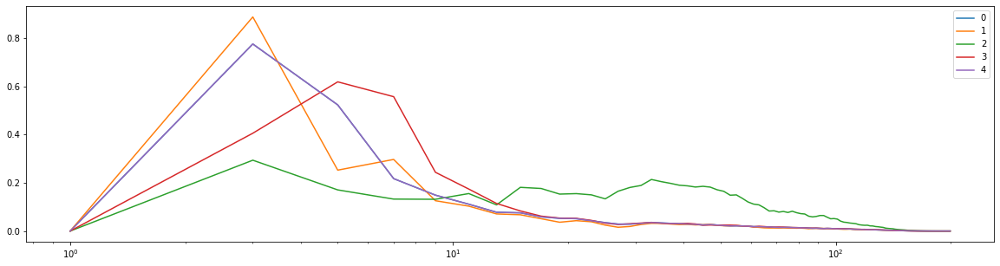

In [465]:
plt.figure(figsize=(20,5))
for i in range(means3.shape[1]):
    plt.semilogx(f+1, evt_psd[:,i], label=i)
plt.legend()

In [492]:
dots = np.zeros((evt_psd_mc.shape[1], evt_psd_mc.shape[1]))
evt_psd_norm = normalize(evt_psd_mc, norm='l2', axis=0, copy=True)
for i in range(evt_psd_norm.shape[1]):
    for j in range(evt_psd_norm.shape[1]):
        dots[i,j] = np.dot(evt_psd_norm[:,i], evt_psd_norm[:,j])

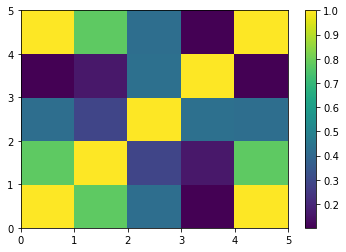

In [493]:
plt.pcolormesh(np.abs(dots)); plt.colorbar();

In [495]:
np.isclose(dots[0,4],1)

True

In [466]:
onehot_encoder = OneHotEncoder(sparse=False)
integer_encoded = evs.reshape(len(evs), 1)
onehot_encoded = onehot_encoder.fit_transform(integer_encoded)

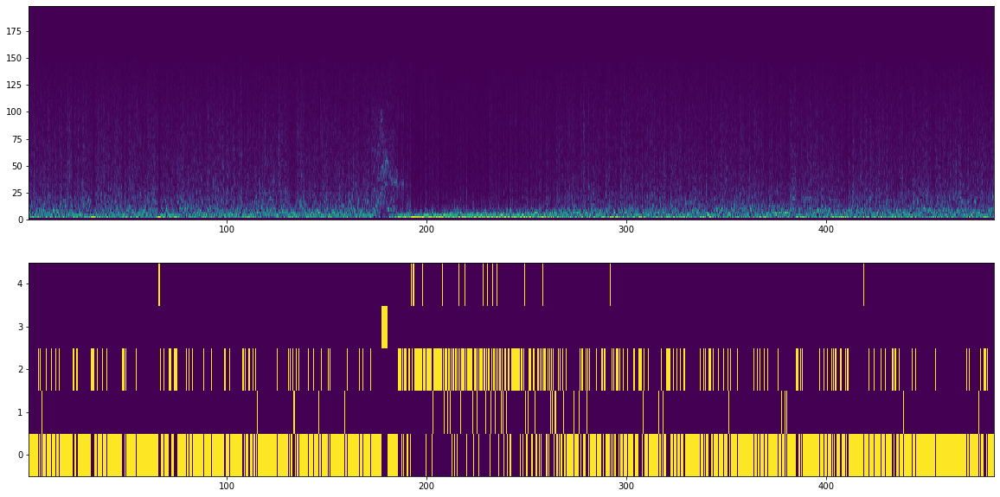

In [467]:
plt.subplots(2,1, figsize=(20,10));
plt.subplot(2,1,1); plt.pcolormesh(t, f, dtft_norm);
plt.subplot(2,1,2); plt.pcolormesh(t, np.arange(-0.5, nevs+0.5), onehot_encoded.T);  plt.yticks(np.arange(nevs));

## Rough estimate of states

In [468]:
window_size = 60 * (512 // nperseg) # window size in seconds
step_size = 3 * window_size//4 # window overlap

In [479]:
evt_frequency = np.empty((len(np.arange(0, len(evs)-window_size, step_size)), nsubclusters))
start_points = np.arange(0, len(evs)-window_size, step_size)
t_states = np.array([])
for i in range(len(start_points)):
    evt_count = np.array([])
    t_states = np.append(t_states, t[start_points[i] + window_size//2])

    for j in range(nsubclusters):
        evt_count = np.append(evt_count, np.sum(evs[start_points[i]:start_points[i]+window_size]==j))
    
    evt_frequency[i,:]=evt_count/np.sum(evt_count)

In [480]:
states_prior = 10
sgm = BayesianGaussianMixture(n_components=states_prior, covariance_type='diag').fit(evt_frequency)
states = sgm.predict(evt_frequency)

In [481]:
state_ids, state_counts = np.unique(states, return_counts=True)
print("nstates = {}".format(len(state_ids)))
nstates = len(state_ids)

nstates = 3


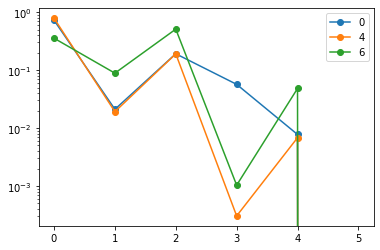

In [485]:
for s in state_ids:
    plt.semilogy(sgm.means_[s,:], 'o-', label=s)
plt.legend()

In [473]:
states_encoded = states.reshape(len(states), 1)
onehot_states = onehot_encoder.fit_transform(states_encoded)

TypeError: Dimensions of C (3, 3) are incompatible with X (21) and/or Y (4); see help(pcolormesh)

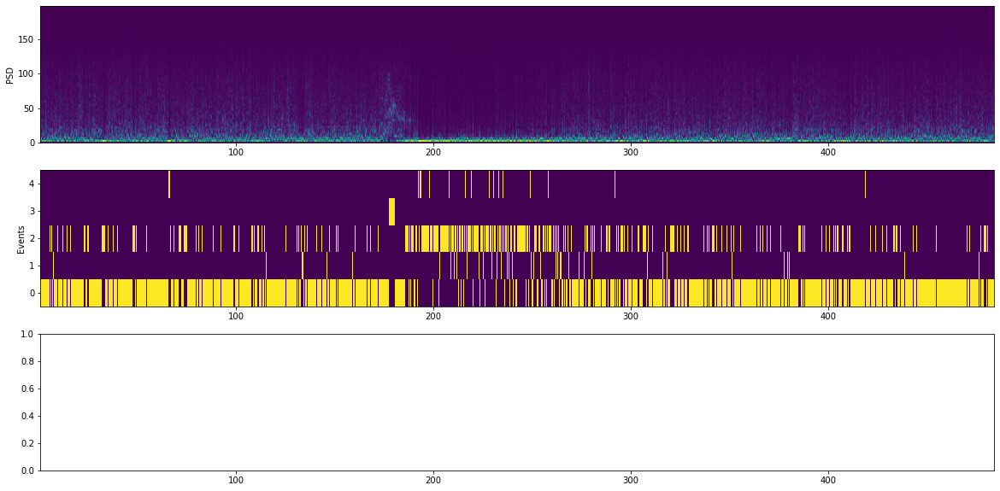

In [474]:
plt.subplots(3,1, figsize=(20,10), sharex='all')
ax = plt.subplot(3,1,1); plt.pcolormesh(t, f, dtft_norm); plt.ylabel('PSD')
plt.subplot(3,1,2, sharex=ax); plt.pcolormesh(t, np.arange(-0.5, nevs + 0.5), onehot_encoded.T);  plt.yticks(np.arange(0, nevs)); plt.ylabel('Events');
plt.subplot(3,1,3, sharex=ax); plt.pcolormesh(t_states, np.arange(-0.5, nstates + 0.5), onehot_states.T);  plt.yticks(np.arange(0, nstates)); plt.ylabel('States');